<a href="https://colab.research.google.com/github/Ajay-Singh-Dabi/Minor/blob/master/H_264_AVC_video_compress.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
import subprocess

input_file = 'cinnamon_girl.mp4'
output_file = 'compressed_video.mp4'

# Use ffmpeg to compress the video using the H.264 codec
command = f'ffmpeg -i {input_file} -c:v libx264 -preset veryslow -crf 28 {output_file}'
subprocess.call(command, shell=True)


1

In [ ]:
import os
file_stats = os.stat('cinnamon_girl')

print(file_stats)
print(f'File Size in Bytes is {file_stats.st_size}')

FileNotFoundError: ignored

In [ ]:
import subprocess

compressed_file = 'compressed_video.mp4'
output_file = 'decompressed_video.mp4'

# Use ffmpeg to decompress the video
command = f'ffmpeg -i {compressed_file} {output_file}'
subprocess.call(command, shell=True)


In [ ]:
from google.colab.patches import cv2_imshow

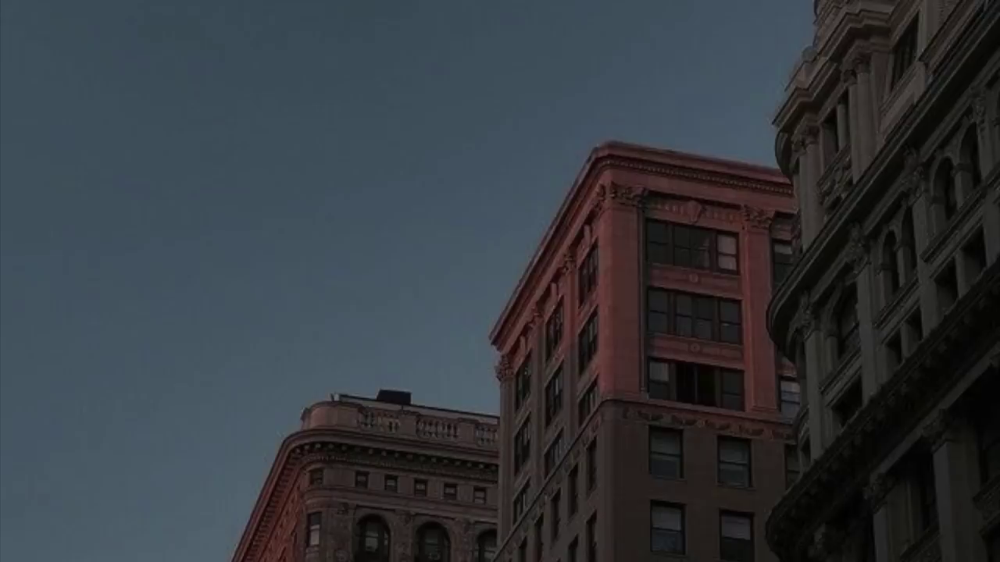

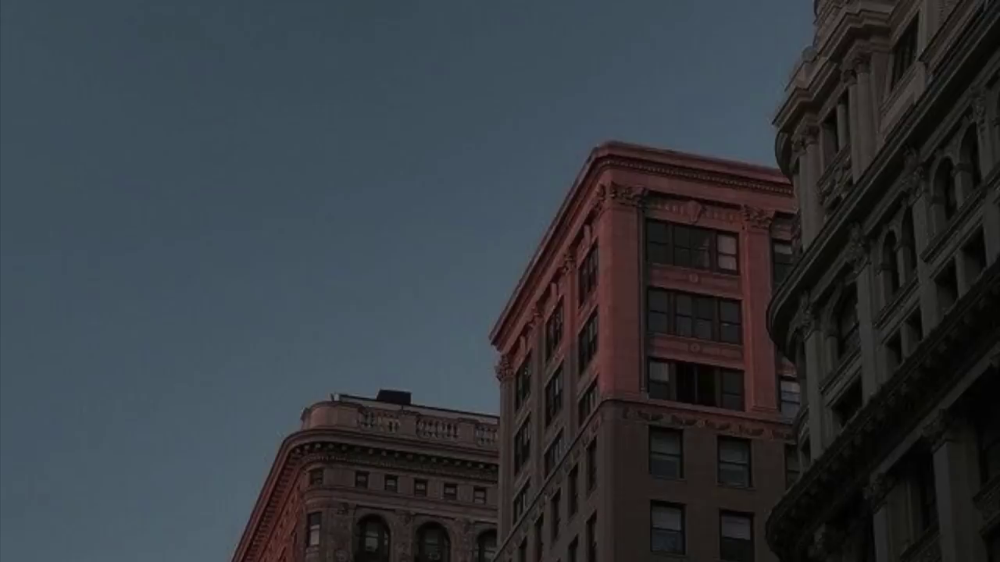

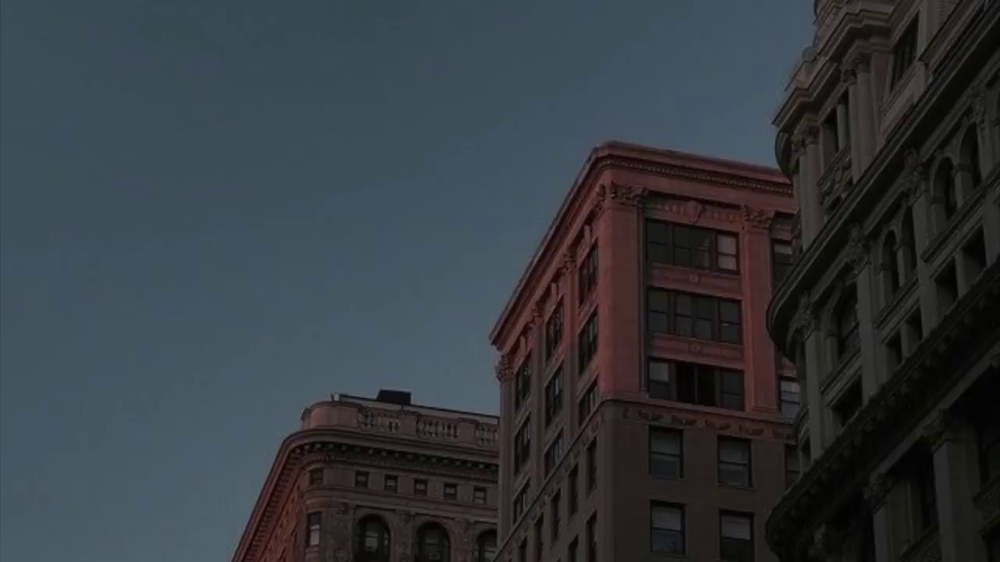

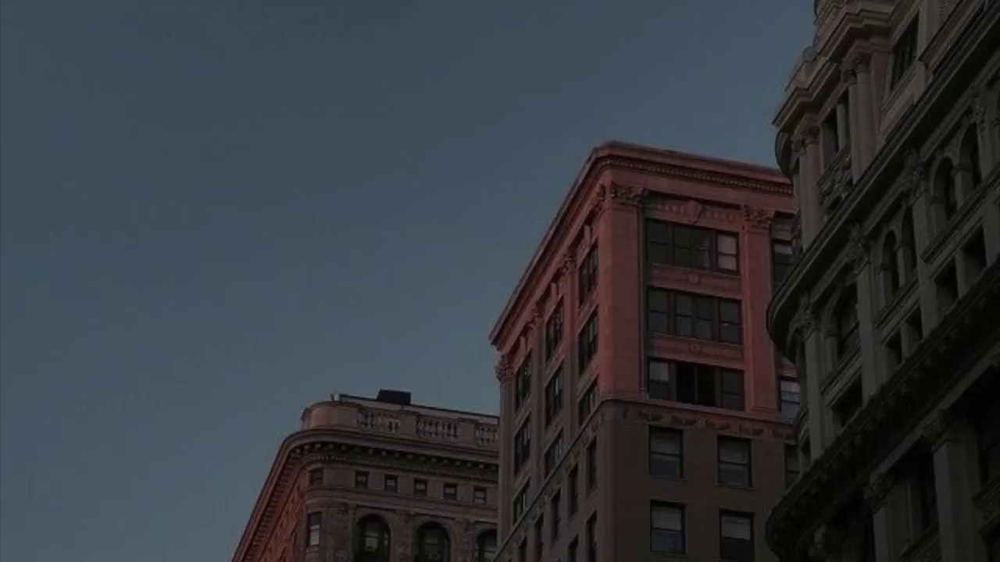

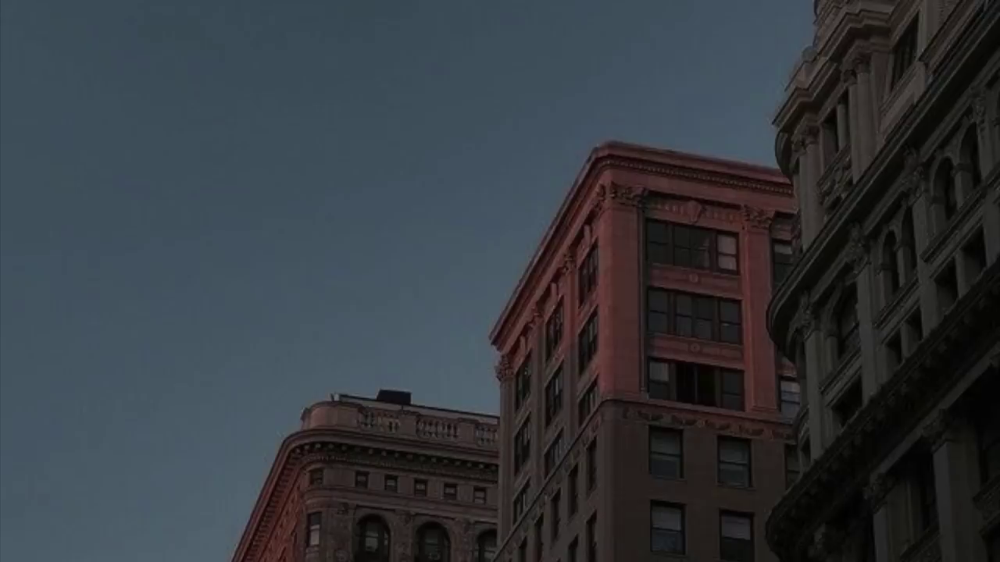

...

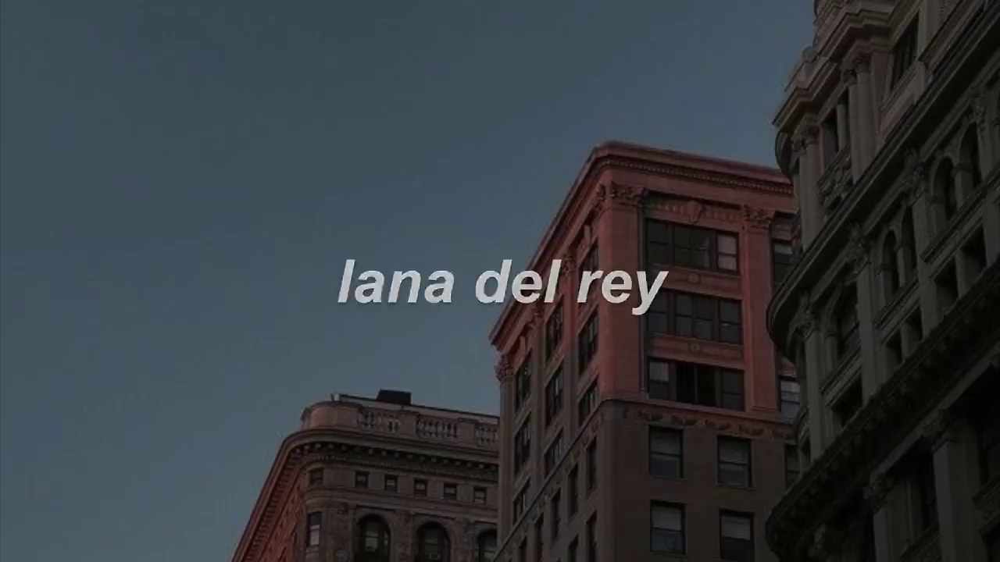

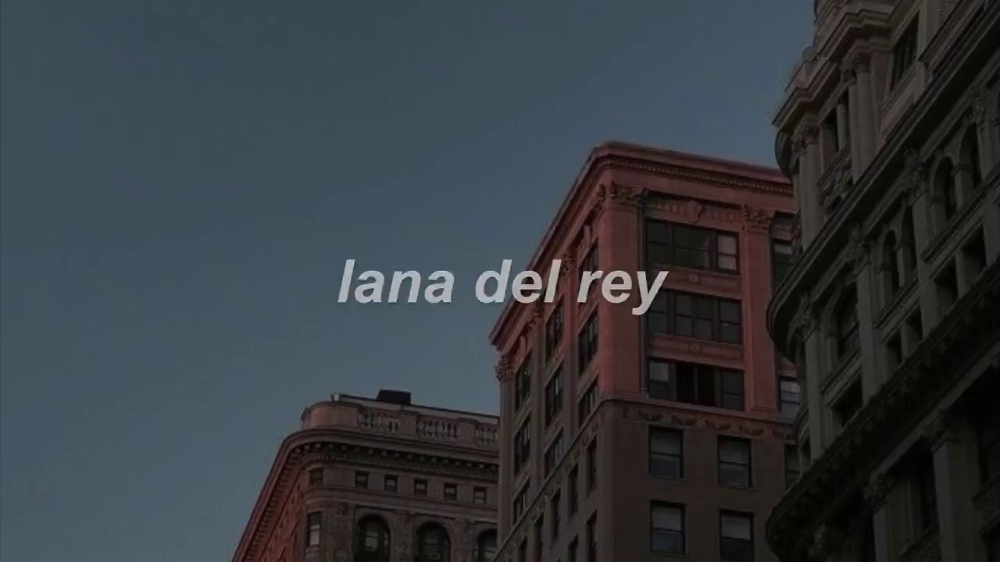

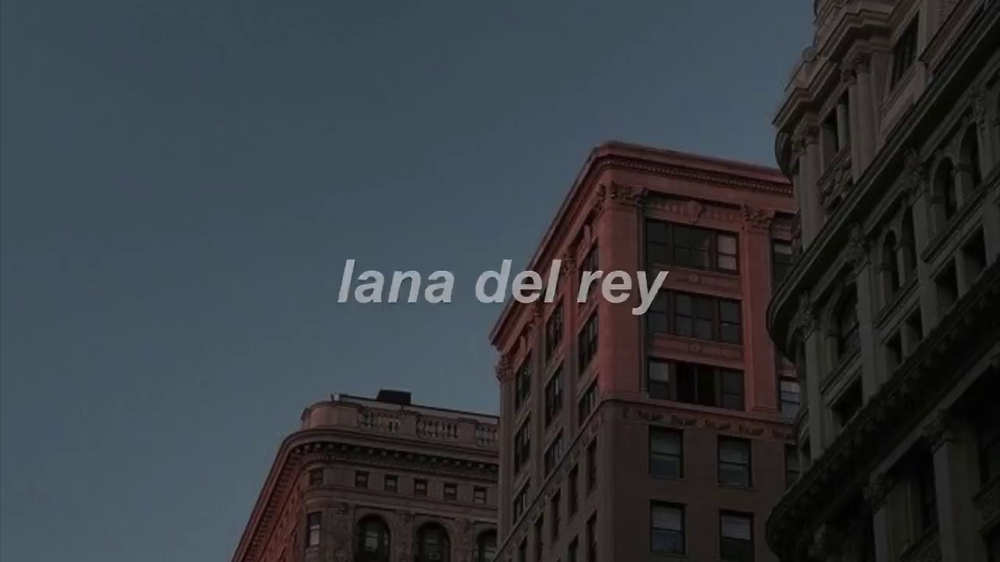

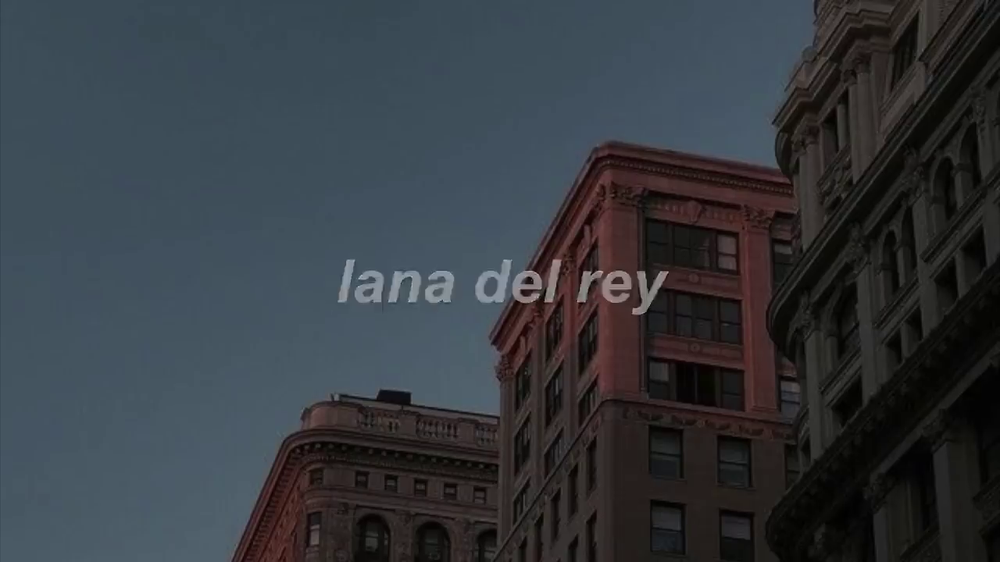

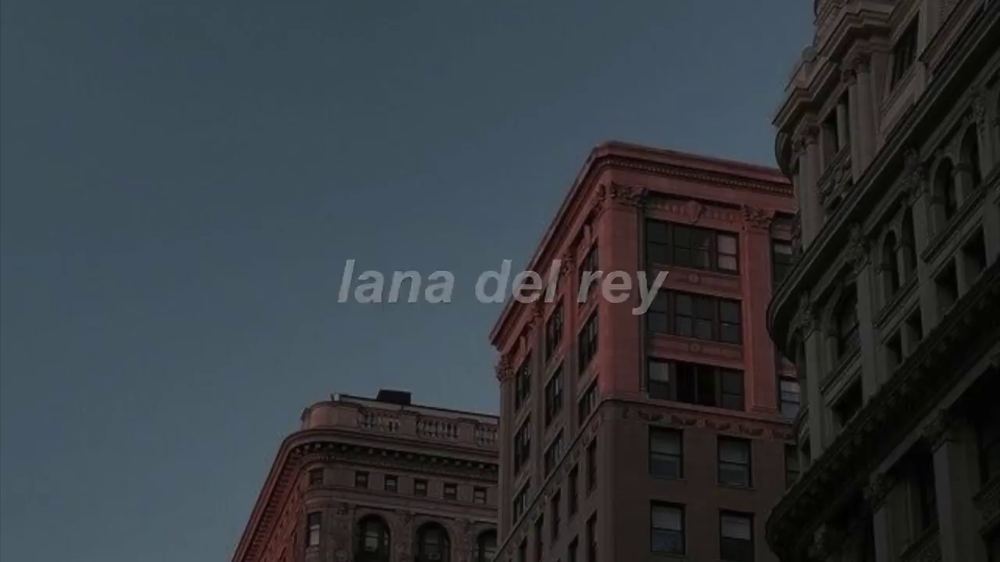

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2

# Read the input video file
cap = cv2.VideoCapture('cinnamon_girl.mp4')

# Get the video properties
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Define the codec and output format
fourcc = cv2.VideoWriter_fourcc(*'VP90')
out = cv2.VideoWriter('output.webm', fourcc, fps, (width, height))

# Loop through the frames of the input video and compress each frame
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        # Preprocess the frame if necessary
        # For example, you could resize the frame to a lower resolution
        # or apply a denoising filter to reduce noise in the video
        # frame = cv2.resize(frame, (640, 480))
        # frame = cv2.fastNlMeansDenoisingColored(frame, None, 10, 10, 7, 21)

        # Compress the frame using VP9 codec
        out.write(frame)

        # Display the compressed frame if desired
        cv2_imshow(frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release the video capture and writer objects
cap.release()
out.release()
cv2.destroyAllWindows()

In [ ]:
import cv2

# Read the compressed video file
cap = cv2.VideoCapture('output.webm')

# Get the video properties
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Define the codec and output format for the decompressed video
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('decompressed.mp4', fourcc, fps, (width, height))

# Loop through the frames of the compressed video and decompress each frame
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        # Write the decompressed frame to the output file
        out.write(frame)

        # Display the decompressed frame if desired
        cv2.imshow('frame', frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release the video capture and writer objects
cap.release()
out.release()
cv2.destroyAllWindows()


In [ ]:
import cv2

# Open the input video file
cap = cv2.VideoCapture('cinnamon_girl.mp4')

# Get the input video properties
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Define the output video codec and format
fourcc = cv2.VideoWriter_fourcc(*'HEVC')
out = cv2.VideoWriter('output.mp4', fourcc, fps, (width, height))

# Loop through the frames of the input video and compress each frame using HEVC/H.265
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        # Compress the frame using HEVC/H.265
        compressed_frame, compressed_flag = cv2.imencode('.mp4', frame, [cv2.IMWRITE_HEVC_QUALITY, 50])

        # If the compression was successful, write the compressed frame to the output video
        if compressed_flag:
            out.write(compressed_frame)

        # Display the compressed frame if desired
        cv2.imshow('frame', compressed_frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release the video capture and writer objects
cap.release()
out.release()
cv2.destroyAllWindows()


In [ ]:
import subprocess

# set the path and name of the input video file
input_file = 'cinnamon_girl.mp4'

# set the path and name of the output video file
output_file = 'output_video.mp4'

# set the desired video bitrate (in kbps)
bitrate = '100000'

# set the ffmpeg command to compress the video
ffmpeg_cmd = ['ffmpeg', '-i', input_file, '-b:v', bitrate + 'k', '-y', output_file]

# call the ffmpeg command using subprocess
subprocess.call(ffmpeg_cmd)

print('Compression complete.')


Compression complete.
